In [1]:

# imports
import os
import sys
import types
import json
import base64

# figure size/format
fig_width = 8
fig_height = 5
fig_format = 'retina'
fig_dpi = 96
interactivity = ''
is_shiny = False
is_dashboard = False
plotly_connected = True

# matplotlib defaults / format
try:
  import matplotlib.pyplot as plt
  plt.rcParams['figure.figsize'] = (fig_width, fig_height)
  plt.rcParams['figure.dpi'] = fig_dpi
  plt.rcParams['savefig.dpi'] = "figure"
  from IPython.display import set_matplotlib_formats
  set_matplotlib_formats(fig_format)
except Exception:
  pass

# plotly use connected mode
try:
  import plotly.io as pio
  if plotly_connected:
    pio.renderers.default = "notebook_connected"
  else:
    pio.renderers.default = "notebook"
  for template in pio.templates.keys():
    pio.templates[template].layout.margin = dict(t=30,r=0,b=0,l=0)
except Exception:
  pass

# disable itables paging for dashboards
if is_dashboard:
  try:
    from itables import options
    options.dom = 'fiBrtlp'
    options.maxBytes = 1024 * 1024
    options.language = dict(info = "Showing _TOTAL_ entries")
    options.classes = "display nowrap compact"
    options.paging = False
    options.searching = True
    options.ordering = True
    options.info = True
    options.lengthChange = False
    options.autoWidth = False
    options.responsive = True
    options.keys = True
    options.buttons = []
  except Exception:
    pass
  
  try:
    import altair as alt
    # By default, dashboards will have container sized
    # vega visualizations which allows them to flow reasonably
    theme_sentinel = '_quarto-dashboard-internal'
    def make_theme(name):
        nonTheme = alt.themes._plugins[name]    
        def patch_theme(*args, **kwargs):
            existingTheme = nonTheme()
            if 'height' not in existingTheme:
              existingTheme['height'] = 'container'
            if 'width' not in existingTheme:
              existingTheme['width'] = 'container'

            if 'config' not in existingTheme:
              existingTheme['config'] = dict()
            
            # Configure the default font sizes
            title_font_size = 15
            header_font_size = 13
            axis_font_size = 12
            legend_font_size = 12
            mark_font_size = 12
            tooltip = False

            config = existingTheme['config']

            # The Axis
            if 'axis' not in config:
              config['axis'] = dict()
            axis = config['axis']
            if 'labelFontSize' not in axis:
              axis['labelFontSize'] = axis_font_size
            if 'titleFontSize' not in axis:
              axis['titleFontSize'] = axis_font_size  

            # The legend
            if 'legend' not in config:
              config['legend'] = dict()
            legend = config['legend']
            if 'labelFontSize' not in legend:
              legend['labelFontSize'] = legend_font_size
            if 'titleFontSize' not in legend:
              legend['titleFontSize'] = legend_font_size  

            # The header
            if 'header' not in config:
              config['header'] = dict()
            header = config['header']
            if 'labelFontSize' not in header:
              header['labelFontSize'] = header_font_size
            if 'titleFontSize' not in header:
              header['titleFontSize'] = header_font_size    

            # Title
            if 'title' not in config:
              config['title'] = dict()
            title = config['title']
            if 'fontSize' not in title:
              title['fontSize'] = title_font_size

            # Marks
            if 'mark' not in config:
              config['mark'] = dict()
            mark = config['mark']
            if 'fontSize' not in mark:
              mark['fontSize'] = mark_font_size

            # Mark tooltips
            if tooltip and 'tooltip' not in mark:
              mark['tooltip'] = dict(content="encoding")

            return existingTheme
            
        return patch_theme

    # We can only do this once per session
    if theme_sentinel not in alt.themes.names():
      for name in alt.themes.names():
        alt.themes.register(name, make_theme(name))
      
      # register a sentinel theme so we only do this once
      alt.themes.register(theme_sentinel, make_theme('default'))
      alt.themes.enable('default')

  except Exception:
    pass

# enable pandas latex repr when targeting pdfs
try:
  import pandas as pd
  if fig_format == 'pdf':
    pd.set_option('display.latex.repr', True)
except Exception:
  pass

# interactivity
if interactivity:
  from IPython.core.interactiveshell import InteractiveShell
  InteractiveShell.ast_node_interactivity = interactivity

# NOTE: the kernel_deps code is repeated in the cleanup.py file
# (we can't easily share this code b/c of the way it is run).
# If you edit this code also edit the same code in cleanup.py!

# output kernel dependencies
kernel_deps = dict()
for module in list(sys.modules.values()):
  # Some modules play games with sys.modules (e.g. email/__init__.py
  # in the standard library), and occasionally this can cause strange
  # failures in getattr.  Just ignore anything that's not an ordinary
  # module.
  if not isinstance(module, types.ModuleType):
    continue
  path = getattr(module, "__file__", None)
  if not path:
    continue
  if path.endswith(".pyc") or path.endswith(".pyo"):
    path = path[:-1]
  if not os.path.exists(path):
    continue
  kernel_deps[path] = os.stat(path).st_mtime
print(json.dumps(kernel_deps))

# set run_path if requested
run_path = 'L2hvbWUvc2ZvdWNoZXIvREVWL1RyYWl0ZW1lbnRJbWFnZXNQeXRob25Wb2wx'
if run_path:
  # hex-decode the path
  run_path = base64.b64decode(run_path.encode("utf-8")).decode("utf-8")
  os.chdir(run_path)

# reset state
%reset

# shiny
# Checking for shiny by using False directly because we're after the %reset. We don't want
# to set a variable that stays in global scope.
if False:
  try:
    import htmltools as _htmltools
    import ast as _ast

    _htmltools.html_dependency_render_mode = "json"

    # This decorator will be added to all function definitions
    def _display_if_has_repr_html(x):
      try:
        # IPython 7.14 preferred import
        from IPython.display import display, HTML
      except:
        from IPython.core.display import display, HTML

      if hasattr(x, '_repr_html_'):
        display(HTML(x._repr_html_()))
      return x

    # ideally we would undo the call to ast_transformers.append
    # at the end of this block whenver an error occurs, we do 
    # this for now as it will only be a problem if the user 
    # switches from shiny to not-shiny mode (and even then likely
    # won't matter)
    import builtins
    builtins._display_if_has_repr_html = _display_if_has_repr_html

    class _FunctionDefReprHtml(_ast.NodeTransformer):
      def visit_FunctionDef(self, node):
        node.decorator_list.insert(
          0,
          _ast.Name(id="_display_if_has_repr_html", ctx=_ast.Load())
        )
        return node

      def visit_AsyncFunctionDef(self, node):
        node.decorator_list.insert(
          0,
          _ast.Name(id="_display_if_has_repr_html", ctx=_ast.Load())
        )
        return node

    ip = get_ipython()
    ip.ast_transformers.append(_FunctionDefReprHtml())

  except:
    pass

def ojs_define(**kwargs):
  import json
  try:
    # IPython 7.14 preferred import
    from IPython.display import display, HTML
  except:
    from IPython.core.display import display, HTML

  # do some minor magic for convenience when handling pandas
  # dataframes
  def convert(v):
    try:
      import pandas as pd
    except ModuleNotFoundError: # don't do the magic when pandas is not available
      return v
    if type(v) == pd.Series:
      v = pd.DataFrame(v)
    if type(v) == pd.DataFrame:
      j = json.loads(v.T.to_json(orient='split'))
      return dict((k,v) for (k,v) in zip(j["index"], j["data"]))
    else:
      return v

  v = dict(contents=list(dict(name=key, value=convert(value)) for (key, value) in kwargs.items()))
  display(HTML('<script type="ojs-define">' + json.dumps(v) + '</script>'), metadata=dict(ojs_define = True))
globals()["ojs_define"] = ojs_define
globals()["__spec__"] = None

/tmp/ipykernel_9754/2500174000.py:25: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats(fig_format)


{"/home/sfoucher/miniconda3/lib/python3.10/importlib/_bootstrap.py": 1733934987.5750644, "/home/sfoucher/miniconda3/lib/python3.10/importlib/_bootstrap_external.py": 1733934987.5750644, "/home/sfoucher/miniconda3/lib/python3.10/codecs.py": 1733934987.0790741, "/home/sfoucher/miniconda3/lib/python3.10/encodings/aliases.py": 1733934987.3590686, "/home/sfoucher/miniconda3/lib/python3.10/encodings/__init__.py": 1733934987.4150677, "/home/sfoucher/miniconda3/lib/python3.10/encodings/utf_8.py": 1733934987.4670665, "/home/sfoucher/miniconda3/lib/python3.10/abc.py": 1733934987.0590746, "/home/sfoucher/miniconda3/lib/python3.10/io.py": 1733934987.1190734, "/home/sfoucher/miniconda3/lib/python3.10/stat.py": 1733934987.1790721, "/home/sfoucher/miniconda3/lib/python3.10/_collections_abc.py": 1733934987.0790741, "/home/sfoucher/miniconda3/lib/python3.10/genericpath.py": 1733934987.1030736, "/home/sfoucher/miniconda3/lib/python3.10/posixpath.py": 1733934987.1470728, "/home/sfoucher/miniconda3/lib/py

In [2]:
%%capture
!pip install -qU matplotlib rioxarray xrscipy scikit-image

In [3]:
import numpy as np
import numpy.fft
import rioxarray as rxr
from scipy import signal, ndimage
import xarray as xr
import xrscipy
import matplotlib.pyplot as plt
from skimage import data, measure, graph, segmentation, color
from skimage.color import rgb2gray
from skimage.segmentation import slic, mark_boundaries
import pandas as pd

In [4]:
#| eval: false
%%capture
import gdown

gdown.download('https://drive.google.com/uc?export=download&confirm=pbef&id=1a6Ypg0g1Oy4AJt9XWKWfnR12NW1XhNg_', output= 'RGBNIR_of_S2A.tif')
gdown.download('https://drive.google.com/uc?export=download&confirm=pbef&id=1a4PQ68Ru8zBphbQ22j0sgJ4D2quw-Wo6', output= 'landsat7.tif')
gdown.download('https://drive.google.com/uc?export=download&confirm=pbef&id=1_zwCLN-x7XJcNHJCH6Z8upEdUXtVtvs1', output= 'berkeley.jpg')
gdown.download('https://drive.google.com/uc?export=download&confirm=pbef&id=1dM6IVqjba6GHwTLmI7CpX8GP2z5txUq6', output= 'SAR.tif')

In [5]:
#| output: false

with rxr.open_rasterio('berkeley.jpg', mask_and_scale= True) as img_rgb:
    print(img_rgb)
with rxr.open_rasterio('RGBNIR_of_S2A.tif', mask_and_scale= True) as img_rgbnir:
    print(img_rgbnir)
with rxr.open_rasterio('SAR.tif', mask_and_scale= True) as img_SAR:
    print(img_SAR)

<xarray.DataArray (band: 3, y: 771, x: 1311)> Size: 12MB
[3032343 values with dtype=float32]
Coordinates:
  * band         (band) int64 24B 1 2 3
  * x            (x) float64 10kB 0.5 1.5 2.5 ... 1.308e+03 1.31e+03 1.31e+03
  * y            (y) float64 6kB 0.5 1.5 2.5 3.5 4.5 ... 767.5 768.5 769.5 770.5
    spatial_ref  int64 8B 0
<xarray.DataArray (band: 4, y: 1926, x: 2074)> Size: 64MB
[15978096 values with dtype=float32]
Coordinates:
  * band         (band) int64 32B 1 2 3 4
  * x            (x) float64 17kB 7.318e+05 7.318e+05 ... 7.525e+05 7.525e+05
  * y            (y) float64 15kB 5.041e+06 5.041e+06 ... 5.022e+06 5.022e+06
    spatial_ref  int64 8B 0
Attributes:
    TIFFTAG_IMAGEDESCRIPTION:  subset_RGBNIR_of_S2A_MSIL2A_20240625T153941_N0...
    TIFFTAG_XRESOLUTION:       1
    TIFFTAG_YRESOLUTION:       1
    TIFFTAG_RESOLUTIONUNIT:    1 (unitless)
    AREA_OR_POINT:             Area
    STATISTICS_MAXIMUM:        15104
    STATISTICS_MEAN:           1426.6252674912
    STATIS

/home/sfoucher/miniconda3/lib/python3.10/site-packages/rioxarray/_io.py:1143: NotGeoreferencedWarning:

Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.
Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


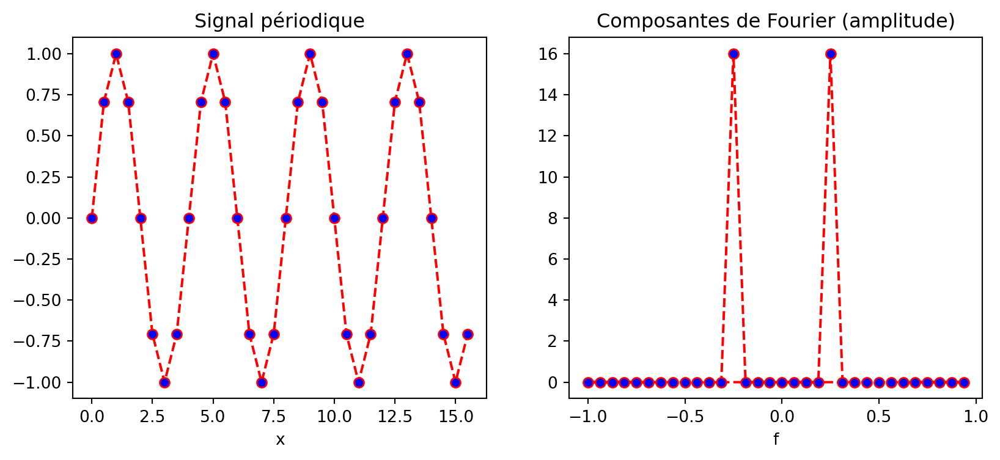

In [6]:
import math
Fs= 2.0
Ts= 1/Fs
N= 16
arr = xr.DataArray(np.sin(2*math.pi*np.arange(0,N,Ts)*4/16),
                   dims=('x'), coords={'x': np.arange(0,N,Ts)})
fourier = np.fft.fft(arr)
freq = np.fft.fftfreq(fourier.size, d=Ts)
fourier = xr.DataArray(fourier,
                   dims=('f'), coords={'f': freq})

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))
plt.subplot(1, 2, 1)
arr.plot.line(color='red', linestyle='dashed', marker='o', markerfacecolor='blue')
axes[0].set_title("Signal périodique")
plt.subplot(1, 2, 2)
np.abs(fourier).plot.line(color='red', linestyle='dashed', marker='o', markerfacecolor='blue')
axes[1].set_title("Composantes de Fourier (amplitude)")
plt.show()

/home/sfoucher/miniconda3/lib/python3.10/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning:

Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.



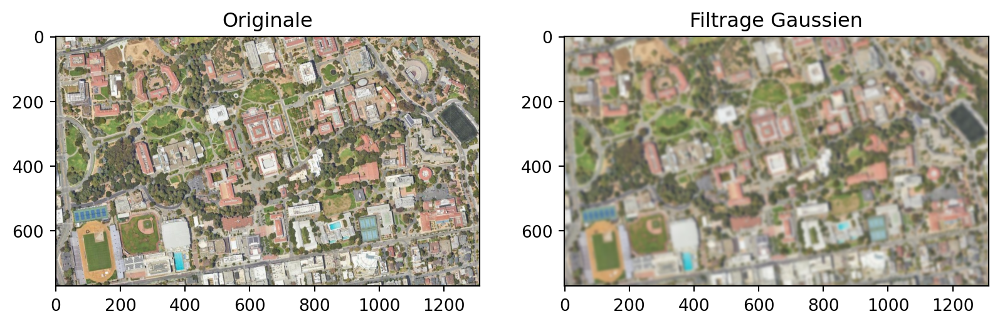

In [7]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))
input_ = numpy.fft.fft2(img_rgb.to_numpy()) 
result = [ndimage.fourier_gaussian(input_[b], sigma=4) for b in range(3)] # on filtre chaque bande avec un filtre Gaussien
result = numpy.fft.ifft2(result)
ax1.imshow(img_rgb.to_numpy().transpose(1, 2, 0).astype('uint8'))
ax1.set_title('Originale')
ax2.imshow(result.real.transpose(1, 2, 0).astype('uint8'))  # La partie imaginaire n'est pas utile ici
ax2.set_title('Filtrage Gaussien')
plt.show()

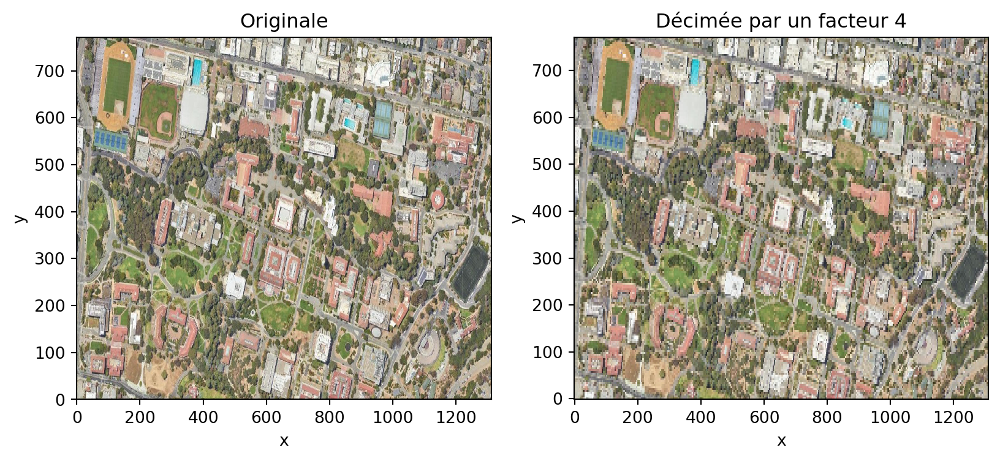

In [8]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))
plt.subplot(1, 2, 1)
img_rgb.astype('int').plot.imshow(rgb="band")
axes[0].set_title("Originale")
plt.subplot(1, 2, 2)
img_rgb[:,::4,::4].astype('int').plot.imshow(rgb="band")
axes[1].set_title("Décimée par un facteur 4")
plt.show()

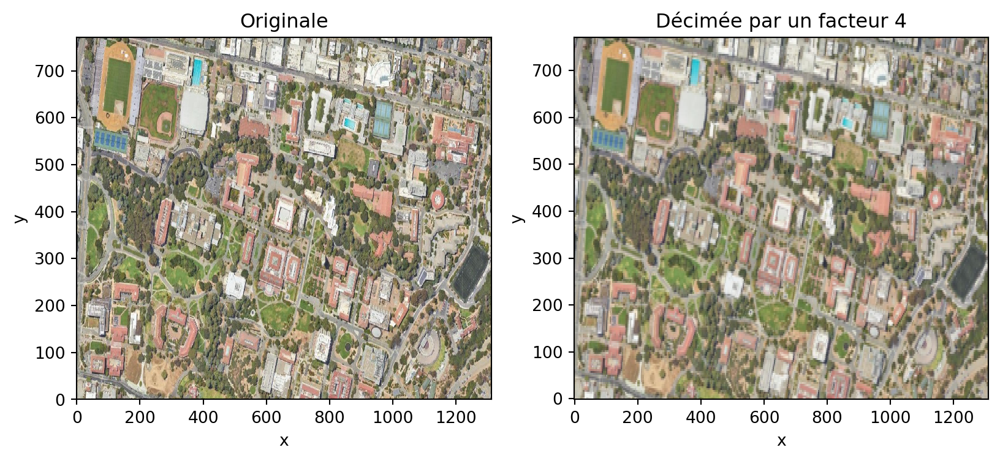

In [9]:
from scipy.ndimage import gaussian_filter
q= 4
sigma= q*1.1774/math.pi
arr = xr.DataArray(gaussian_filter(img_rgb.to_numpy(), sigma= (0,sigma,sigma)), dims=('band',"y", "x"), coords= {'x': img_rgb.coords['x'], 'y': img_rgb.coords['y'], 'spatial_ref': 0})

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))
plt.subplot(1, 2, 1)
img_rgb.astype('int').plot.imshow(rgb="band")
axes[0].set_title("Originale")
plt.subplot(1, 2, 2)
arr[:,::q,::q].astype('int').plot.imshow(rgb="band")
axes[1].set_title("Décimée par un facteur 4")
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [3..265].


Text(0.5, 1.0, 'Décimée par un facteur 4')

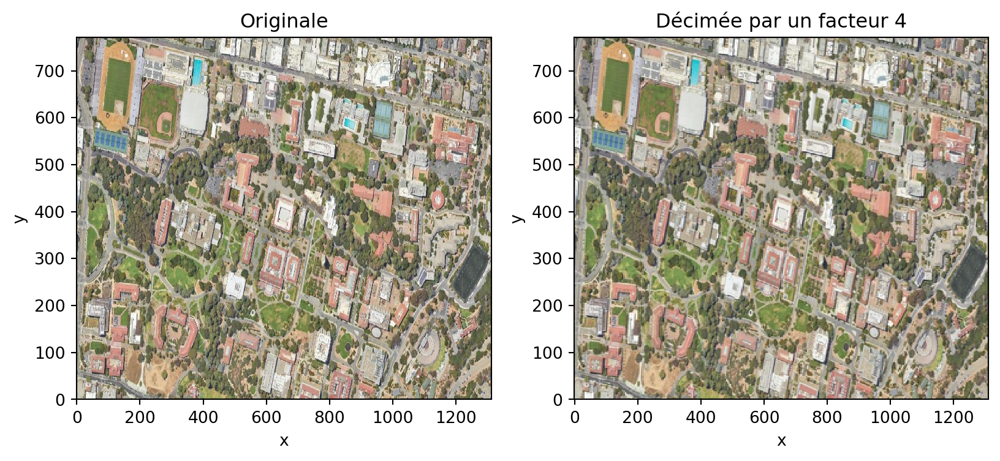

In [10]:
import xrscipy.signal as dsp

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))
plt.subplot(1, 2, 1)
img_rgb.astype('int').plot.imshow(rgb="band")
axes[0].set_title("Originale")
plt.subplot(1, 2, 2)
dsp.decimate(img_rgb, q=4, dim='x').astype('int').plot.imshow(rgb="band")
axes[1].set_title("Décimée par un facteur 4")

In [11]:
rolling_win = img_rgb.rolling(x=5, y=5,  min_periods= 3, center= True).construct(x="x_win", y="y_win", keep_attrs= True)
print(rolling_win[0,0,1,...])
print(rolling_win.shape)

<xarray.DataArray (x_win: 5, y_win: 5)> Size: 100B
array([[ nan,  nan,  nan,  nan,  nan],
       [ nan,  nan, 209., 210., 209.],
       [ nan,  nan, 213., 214., 212.],
       [ nan,  nan, 213., 212., 210.],
       [ nan,  nan, 210., 209., 206.]], dtype=float32)
Coordinates:
    band         int64 8B 1
    x            float64 8B 1.5
    y            float64 8B 0.5
    spatial_ref  int64 8B 0
Dimensions without coordinates: x_win, y_win
(3, 771, 1311, 5, 5)


Text(0.5, 1.0, 'Filtre moyen 5x5')

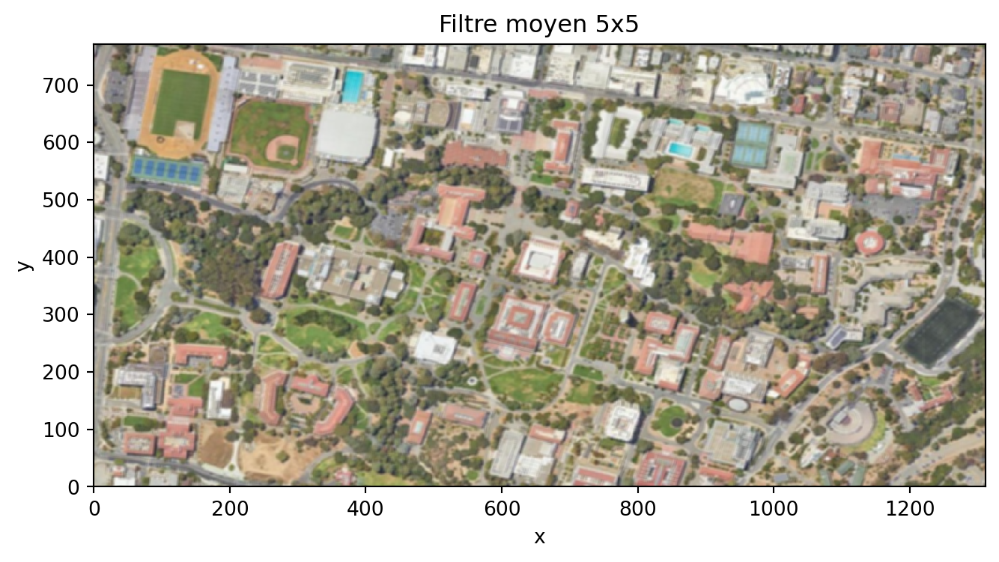

In [12]:
filtre_moyen= rolling_win.mean(dim= ['x_win', 'y_win'], skipna= True)
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 4))
filtre_moyen.astype('int').plot.imshow(rgb="band")
ax.set_title("Filtre moyen 5x5")

In [13]:
#| eval: false
kernel = np.outer(signal.windows.gaussian(70, 8),
                  signal.windows.gaussian(70, 8))
blurred = signal.fftconvolve(img_rgb, kernel, mode='same')

(771, 1311)


<xarray.DataArray (y: 771, x: 1311)> Size: 8MB
array([[  65.96969001,   58.85575588,   54.91812087, ..., 1474.        ,
        1037.01205393,  389.99487176],
       [  61.07372594,   39.8246155 ,   89.18520057, ..., 1763.79647352,
         864.92543031,  270.20362692],
       [  98.48857802,  112.44554237,  168.10710871, ..., 2110.61365484,
         870.36658943,  204.40156555],
       ...,
       [ 143.17821063,  597.00753764, 2479.42977315, ...,  216.00925906,
         248.33847869,  200.89798406],
       [ 106.07544485,  393.67245268, 2188.78824924, ...,  124.96399481,
         159.90622252,  346.34087255],
       [  41.59326869,  229.05894438, 1845.1216762 , ...,  175.16278143,
          33.37663854,  414.3911196 ]])
Coordinates:
  * x            (x) float64 10kB 0.5 1.5 2.5 ... 1.308e+03 1.31e+03 1.31e+03
  * y            (y) float64 6kB 0.5 1.5 2.5 3.5 4.5 ... 767.5 768.5 769.5 770.5
    spatial_ref  int64 8B 0


Text(0.5, 1.0, 'Amplitude du filtre de Scharr')

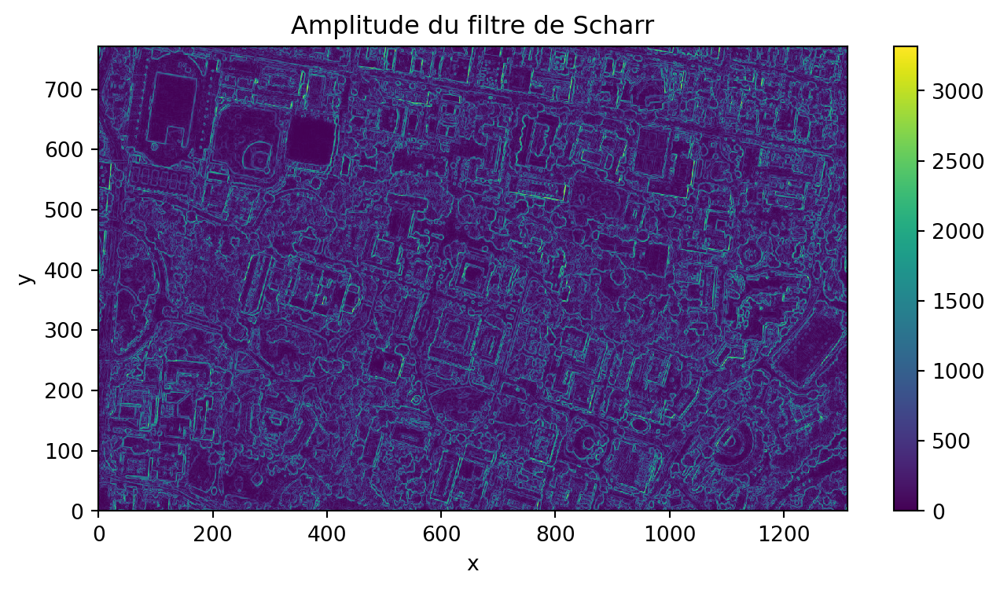

In [14]:
scharr = np.array([[ -3-3j, 0-10j,  +3 -3j],
                   [-10+0j, 0+ 0j, +10 +0j],
                   [ -3+3j, 0+10j,  +3 +3j]]) # Gx + j*Gy
print(img_rgb.isel(band=0).shape)
grad = signal.convolve2d(img_rgb.isel(band=0), scharr, boundary='symm', mode='same')
# on reconstruit un xarray à partir du résultat:
arr = xr.DataArray(np.abs(grad), dims=("y", "x"), coords= {'x': img_rgb.coords['x'], 'y': img_rgb.coords['y'], 'spatial_ref': 0})
print(arr)
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 4))
arr.plot.imshow()
ax.set_title("Amplitude du filtre de Scharr")

(2, 3, 3, 3)
torch.Size([1, 3, 771, 1311])


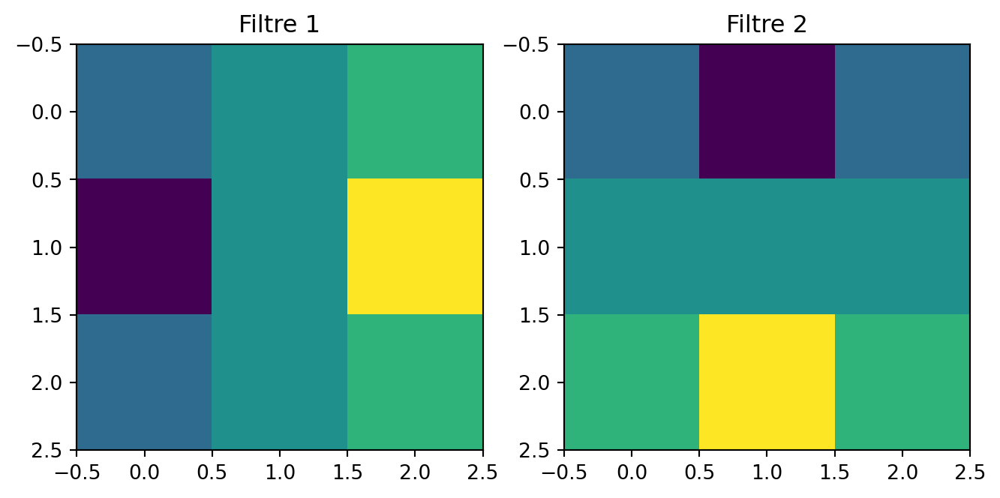

In [15]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
normalized_img= torch.tensor(img_rgb.to_numpy())
nchannels= normalized_img.size()[0] # nombre de canaux de l'image

# On forme une couche convolutionnelle
conv_layer = nn.Conv2d(in_channels= nchannels, out_channels=2, kernel_size=3, padding=1, stride=1, dilation= 1)

# Filtre de Sobel
sobel_x = np.array([[-3, 0, 3], [-10, 0, 10], [-3, 0, 3]])
sobel_y = np.array([[-3, -10, -3], [0, 0, 0], [3, 10, 3]])
# Le filtre (kernel) est formé de deux filtres
kernel = np.stack([sobel_x, sobel_y])
kernel = kernel.reshape(2, 1, 3, 3)
# On répète le filtre pour chaque bande
kernel = np.tile(kernel,(1,nchannels,1,1))
print(kernel.shape)
kernel = torch.as_tensor(kernel,dtype=torch.float32)
conv_layer.weight = nn.Parameter(kernel)
conv_layer.bias = nn.Parameter(torch.zeros(2,))

input= normalized_img.unsqueeze(0) # il faut ajouter une dimension pour le nombre d'échantillons
print(input.shape)
# Visualize the filters
fig, axs = plt.subplots(1, 2, figsize=(8, 5))
for i in range(2):
    axs[i].imshow(conv_layer.weight.data.numpy()[i, 0])
    axs[i].set_title(f'Filtre {i+1}')
plt.show()

Image (BxCxHxW): torch.Size([1, 3, 771, 1311])
Sortie (BxFxHxW): torch.Size([1, 2, 771, 1311])


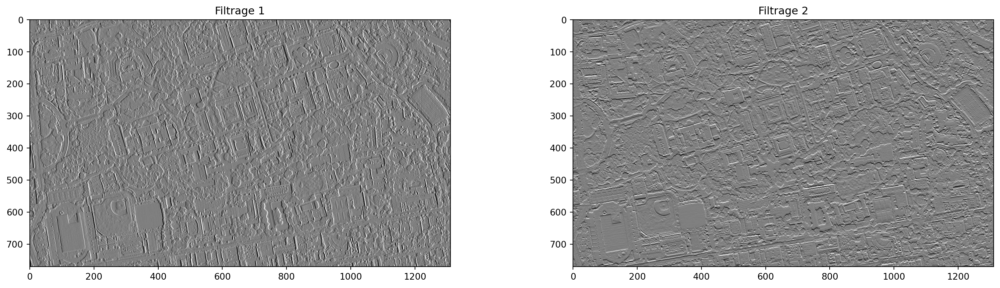

In [16]:
import torch
import matplotlib.pyplot as plt

output = conv_layer(input)
print(f'Image (BxCxHxW): {input.shape}')
print(f'Sortie (BxFxHxW): {output.shape}')

fig, axs = plt.subplots(1, 2, figsize=(20, 5))
for i in range(2):
    axs[i].imshow(output.detach().data.numpy()[0,i], vmin=-5000, vmax=5000, cmap= 'gray')
    axs[i].set_title(f'Filtrage {i+1}')
plt.show()

(0.00029254428869762705, -0.000287092818453516)
EPSG:4326


/tmp/ipykernel_9754/3197635295.py:4: DeprecationWarning:

dropping variables using `drop` is deprecated; use drop_vars.

Warning 1: TIFFReadDirectory:Sum of Photometric type-related color channels and ExtraSamples doesn't match SamplesPerPixel. Defining non-color channels as ExtraSamples.


Text(0.5, 1.0, 'Image SAR Sentinel-1 (dB)')

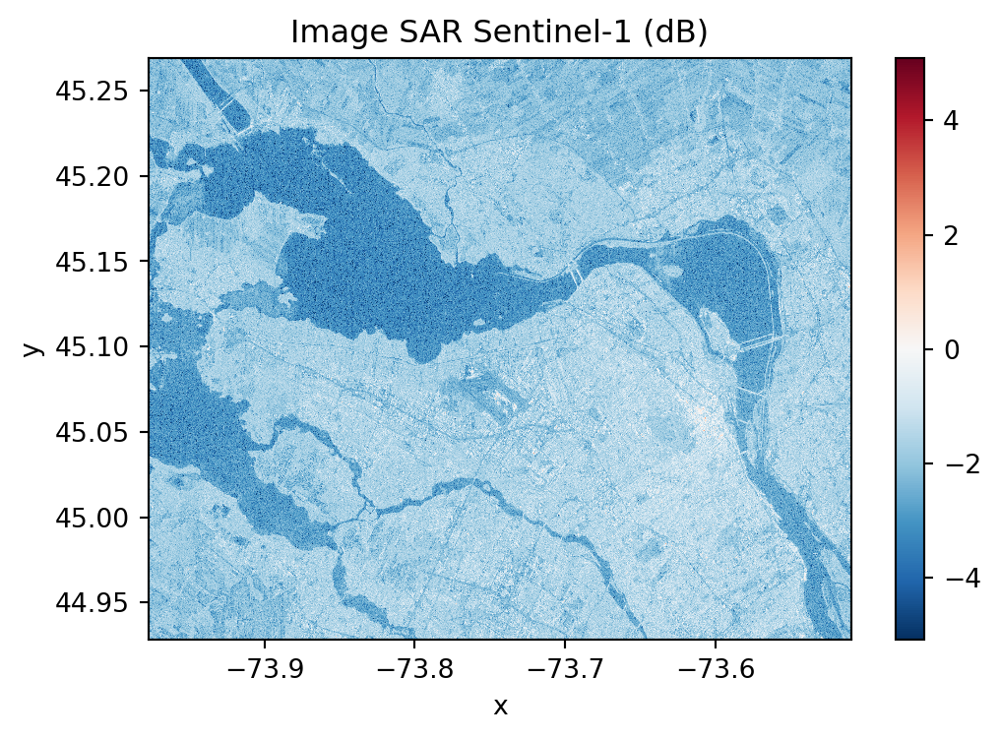

In [17]:
print(img_SAR.rio.resolution())
print(img_SAR.rio.crs)
fig, axs = plt.subplots(1, 1, figsize=(6, 4))
xr.ufuncs.log10(img_SAR.sel(band=1).drop("band")).plot()
axs.set_title("Image SAR Sentinel-1 (dB)")

Text(0.5, 1.0, 'Filtrage moyen 5x5 (dB)')

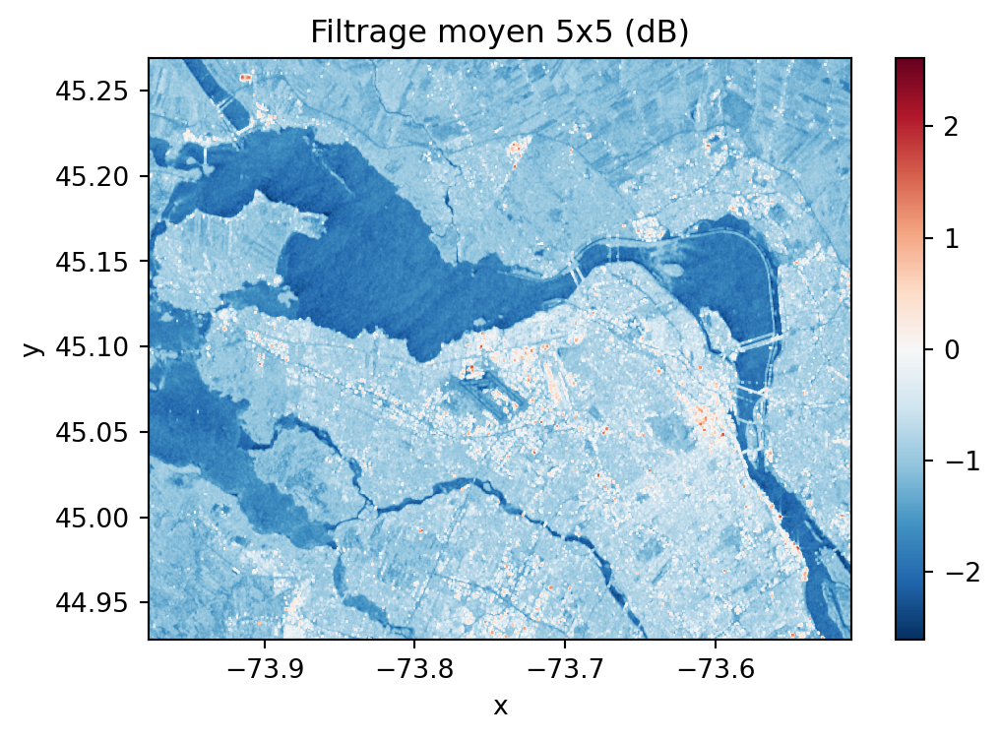

In [18]:
rolling_win = img_SAR.sel(band=2).rolling(x=5, y=5,  min_periods= 3, center= True).construct(x="x_win", y="y_win", keep_attrs= True)
filtre_moyen= rolling_win.mean(dim= ['x_win', 'y_win'], skipna= True)
fig, axs = plt.subplots(1, 1, figsize=(6, 4))
xr.ufuncs.log10(filtre_moyen).plot.imshow()
axs.set_title("Filtrage moyen 5x5 (dB)")

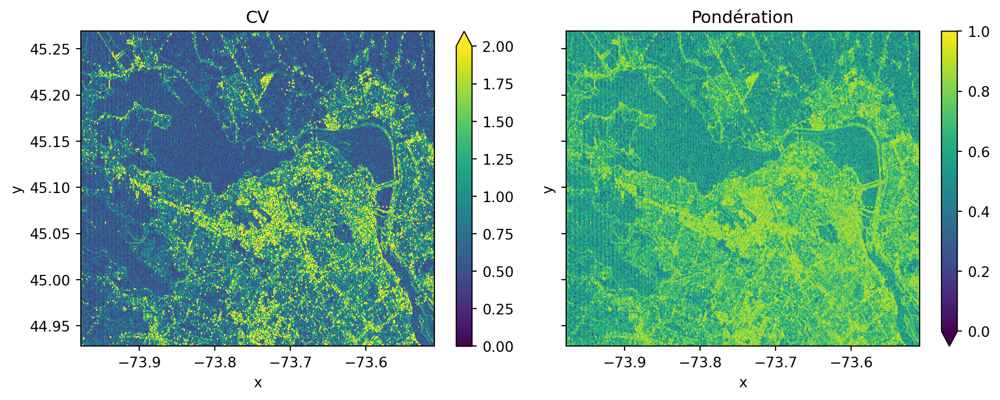

In [19]:
rolling_win = img_SAR.sel(band=2).rolling(x=5, y=5,  min_periods= 3, center= True).construct(x="x_win", y="y_win", keep_attrs= True)
filtre_moyen= rolling_win.mean(dim= ['x_win', 'y_win'], skipna= True)
ecart_type= rolling_win.std(dim= ['x_win', 'y_win'], skipna= True)
cv= ecart_type/filtre_moyen
ponderation = (cv - 0.25) / cv

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4), sharex=True, sharey=True)
plt.subplot(1, 2, 1)
cv.plot.imshow( vmin=0, vmax=2)
axes[0].set_title("CV")
plt.subplot(1, 2, 2)
ponderation.plot.imshow( vmin=0, vmax=1) 
axes[1].set_title("Pondération")
plt.tight_layout()

/tmp/ipykernel_9754/1164062365.py:1: DeprecationWarning:

dropping variables using `drop` is deprecated; use drop_vars.



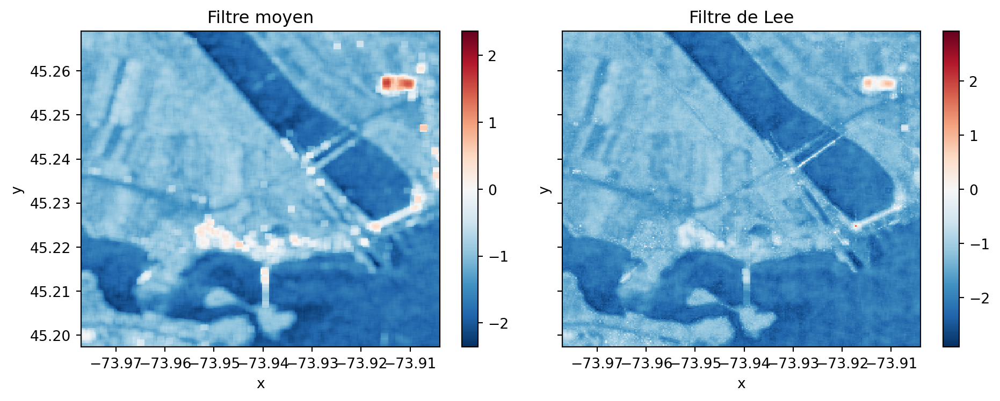

In [20]:
#| echo: false

filtered= filtre_moyen + ponderation * (img_SAR.sel(band=1).drop("band") - filtre_moyen)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4), sharex=True, sharey=True)
plt.subplot(1, 2, 1)
xr.ufuncs.log10(filtre_moyen).isel(x=slice(None, 250),y=slice(None, 250)).plot.imshow()
axes[0].set_title("Filtre moyen")
plt.subplot(1, 2, 2)
xr.ufuncs.log10(filtered).isel(x=slice(None, 250),y=slice(None, 250)).plot.imshow() #cmap=plt.get_cmap('hot'),
axes[1].set_title("Filtre de Lee")
plt.tight_layout()

SLIC nombre de segments: 240


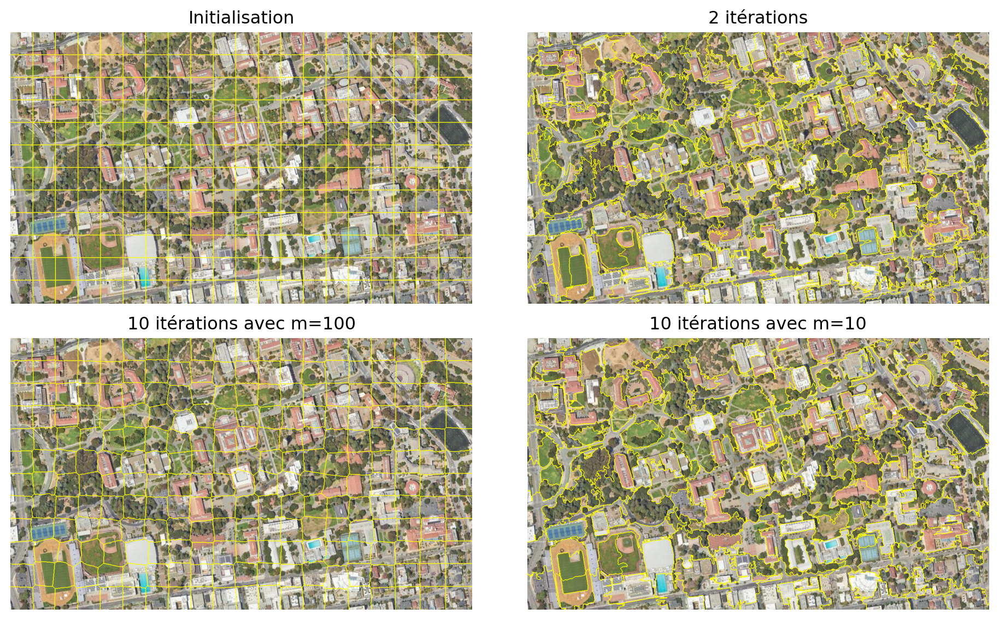

In [21]:
img = img_rgb.to_numpy().astype('uint8').transpose(1,2,0) 

segments_slic1 = slic(img, n_segments=250, compactness=10, sigma=1, start_label=1, max_num_iter=1)
segments_slic2 = slic(img, n_segments=250, compactness=10, sigma=1, start_label=1, max_num_iter=2)
segments_slic100 = slic(img, n_segments=250, compactness=100, sigma=1, start_label=1, max_num_iter=10)
segments_slic100b = slic(img, n_segments=250, compactness=10, sigma=1, start_label=1, max_num_iter=10)

print(f'SLIC nombre de segments: {len(np.unique(segments_slic1))}')

fig, ax = plt.subplots(2, 2, figsize=(10, 6), sharex=True, sharey=True)

ax[0, 0].imshow(mark_boundaries(img, segments_slic1))
ax[0, 0].set_title("Initialisation")
ax[0, 1].imshow(mark_boundaries(img, segments_slic2))
ax[0, 1].set_title('2 itérations')
ax[1, 0].imshow(mark_boundaries(img, segments_slic100))
ax[1, 0].set_title('10 itérations avec m=100')
ax[1, 1].imshow(mark_boundaries(img, segments_slic100b))
ax[1, 1].set_title('10 itérations avec m=10')

for a in ax.ravel():
    a.set_axis_off()

plt.tight_layout()
plt.show()

Nb segments:  631


SLIC nombre de segments: 459


Nb segments:  2526


SLIC nombre de segments: 2201


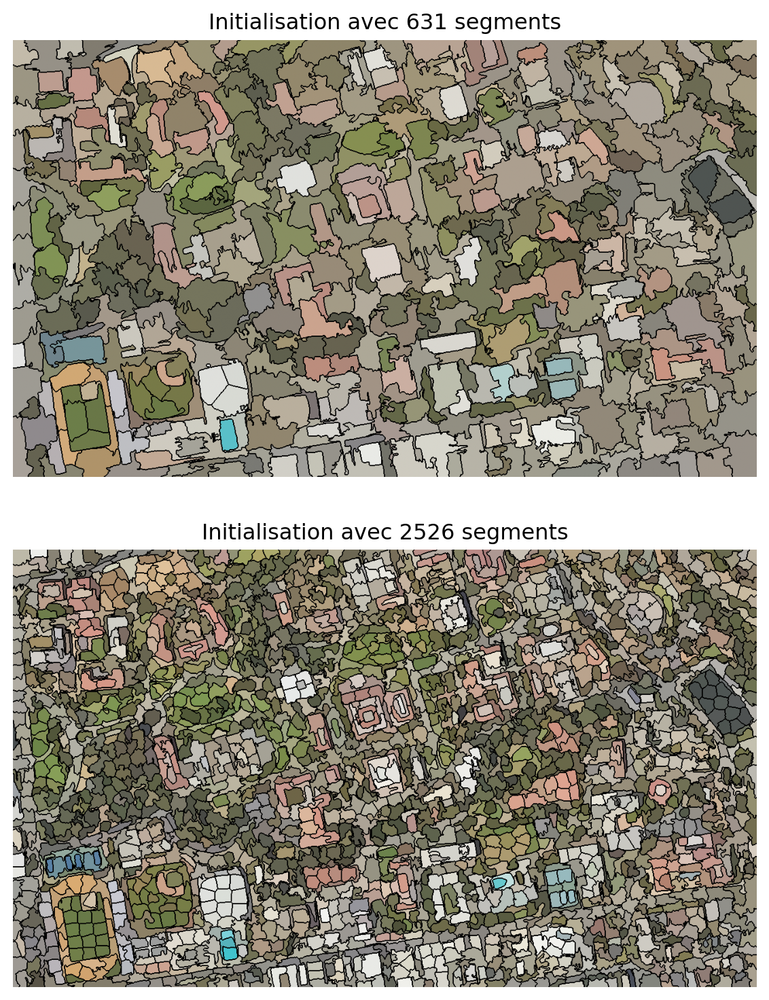

In [22]:
from skimage import color, segmentation
n_regions = int((img.shape[0] * img.shape[1])/(40*40))
print('Nb segments: ',n_regions)
segments_slic_40 = slic(img, n_segments=n_regions, compactness=10, sigma=1, start_label=1, max_num_iter=10)
print(f'SLIC nombre de segments: {len(np.unique(segments_slic_40))}')
out = color.label2rgb(segments_slic_40, img, kind='avg', bg_label=0)
out_40 = segmentation.mark_boundaries(out, segments_slic_40, (0, 0, 0))

n_regions = int((img.shape[0] * img.shape[1])/(20*20))
print('Nb segments: ',n_regions)
segments_slic_20 = slic(img, n_segments=n_regions, compactness=10, sigma=1, start_label=1, max_num_iter=10)
print(f'SLIC nombre de segments: {len(np.unique(segments_slic_20))}')
out = color.label2rgb(segments_slic_20, img, kind='avg', bg_label=0)
out_20 = segmentation.mark_boundaries(out, segments_slic_20, (0, 0, 0))

fig, ax = plt.subplots(2, 1, figsize=(6, 8), sharex=True, sharey=True)

ax[0].imshow(out_40)
ax[0].set_title("Initialisation avec 631 segments")
ax[1].imshow(out_20)
ax[1].set_title('Initialisation avec 2526 segments')
for a in ax.ravel():
    a.set_axis_off()
plt.tight_layout()
plt.show()

Nombre de segments: 2201
Nombre de segments: 1187


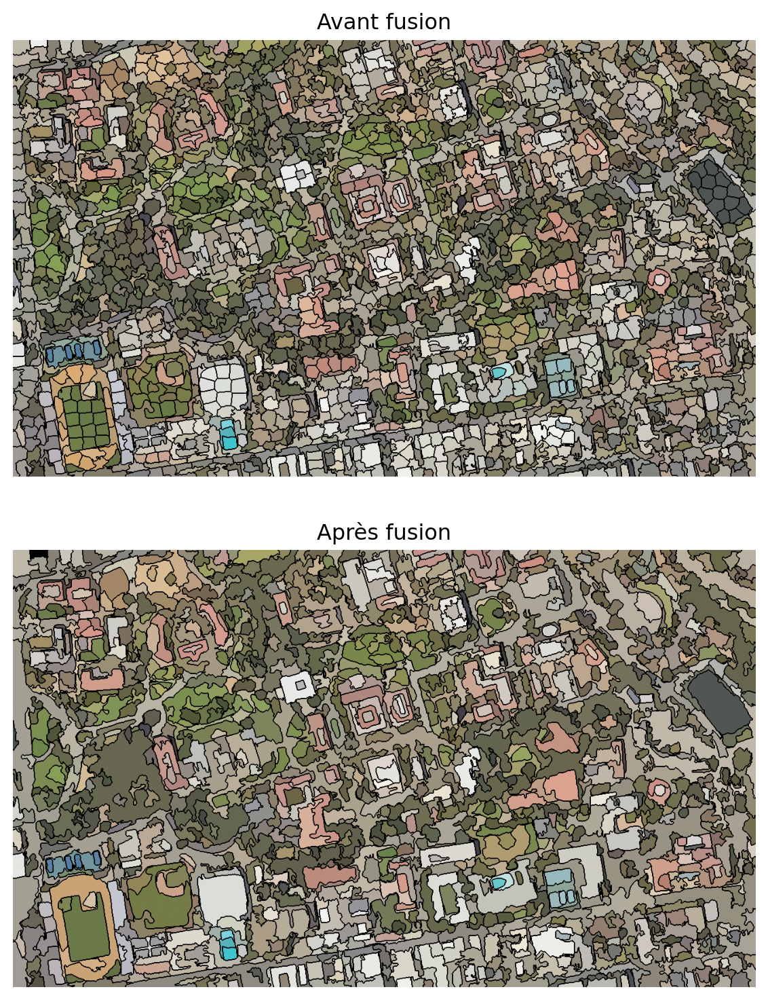

In [23]:
def _weight_mean_color(graph, src, dst, n):
    """Fonction pour gérer la fusion des nœuds en recalculant la couleur moyenne.
    La méthode suppose que la couleur moyenne de `dst` est déjà calculée.
    """
    diff = graph.nodes[dst]['mean color'] - graph.nodes[n]['mean color']
    diff = np.linalg.norm(diff)
    #print(diff)
    return {'weight': diff}


def merge_mean_color(graph, src, dst):
    """Fonction appelée avant la fusion de deux nœuds d'un graphe de distance de couleur moyenne.
      Cette méthode calcule la couleur moyenne de `dst`.
    """
    graph.nodes[dst]['total color'] += graph.nodes[src]['total color']
    graph.nodes[dst]['pixel count'] += graph.nodes[src]['pixel count']
    graph.nodes[dst]['mean color'] = (
        graph.nodes[dst]['total color'] / graph.nodes[dst]['pixel count']
    )
g = graph.rag_mean_color(img, segments_slic_20)
print('Nombre de segments:',len(g))
labels2 = graph.merge_hierarchical(
    segments_slic_20,
    g,
    thresh=20,
    rag_copy=False,
    in_place_merge=True,
    merge_func=merge_mean_color,
    weight_func=_weight_mean_color,
)
print('Nombre de segments:',len(g))

out1 = color.label2rgb(segments_slic_20, img, kind='avg', bg_label=0)
out1 = segmentation.mark_boundaries(out1, segments_slic_20, (0, 0, 0))
out2 = color.label2rgb(labels2, img, kind='avg', bg_label=0)
out2 = segmentation.mark_boundaries(out2, labels2, (0, 0, 0))

fig, ax = plt.subplots(nrows=2, sharex=True, sharey=True, figsize=(6, 8))

ax[0].imshow(out1)
ax[0].set_title("Avant fusion")
ax[1].imshow(out2)
ax[1].set_title("Après fusion")
for a in ax:
    a.axis('off')

plt.tight_layout()

In [24]:
properties = ['label', 'area', 'centroid', 'num_pixels', 'intensity_mean', 'intensity_std']

table=   measure.regionprops_table(labels2, intensity_image= img_rgb.to_numpy().transpose(1,2,0), properties=properties)

table = pd.DataFrame(table)
table.head(10)

,label,area,centroid-0,centroid-1,num_pixels,intensity_mean-0,intensity_mean-1,intensity_mean-2,intensity_std-0,intensity_std-1,intensity_std-2
0,1,641.0,15.466459,69.489860,641,136.730103,132.851791,117.126366,32.289547,31.451048,37.421638
1,2,480.0,10.997917,92.614583,480,201.208328,198.262497,188.483337,14.184592,14.151334,15.475913
2,3,712.0,16.683989,114.776685,712,185.349716,183.113770,170.994385,25.453747,26.184948,28.128426
3,4,1803.0,31.974487,139.379368,1803,117.897392,108.367722,97.769829,31.086676,26.577900,28.297256
4,5,448.0,5.004464,166.542411,448,183.511154,181.276779,167.720978,29.824030,30.625013,31.297607
5,6,459.0,9.934641,191.668845,459,133.557739,133.821350,129.697174,22.902142,23.013086,22.428919
6,7,355.0,5.160563,222.895775,355,148.574646,148.802811,142.580276,21.334805,21.457472,20.931572
7,8,334.0,4.904192,255.904192,334,125.973053,121.197601,108.973053,23.151978,24.556480,25.351229
8,9,1481.0,32.279541,292.865631,1481,204.102631,172.359894,137.501007,13.884891,14.092896,15.865581
9,10,445.0,8.013483,308.053933,445,145.373032,138.182022,121.402245,18.543356,18.644655,22.237881
